# Homework Assignment 8

**Question 1:** Select a book or a movie's subtitle, and find the locations that appear in the book/movie. Then, draw these locations on a map (at least 10 locations) (30pt). Connect the discovered locations with lines according to their order of appearance
in the book. For example, if location B appeared immediately after location A, then draw a line connecting locations A and B (20pt).

In [6]:
!pip install turicreate
!pip install spaCy
!pip install pymongo
!pip install geopandas
!pip install descartes
!pip install geopy
!pip install folium
!pip install imageio
!pip install kaggle 

# Run this to make cartopy work with colab 
!apt-get install libproj-dev proj-data proj-bin
!apt-get install libgeos-dev
!pip install cython
!pip install cartopy
!pip install --no-binary shapely shapely --force

!python -m spacy download en_core_web_lg # Important! you need to restart runtime after install

     |████████████████████████████████| 92.0MB 57kB/s 
     |████████████████████████████████| 327kB 33.9MB/s 
     |████████████████████████████████| 3.6MB 39.1MB/s 
     |████████████████████████████████| 3.5MB 35.8MB/s 
     |████████████████████████████████| 86.4MB 53kB/s 
     |████████████████████████████████| 18.3MB 215kB/s 
     |████████████████████████████████| 51kB 5.5MB/s 
     |████████████████████████████████| 3.8MB 31.9MB/s 
     |████████████████████████████████| 450kB 34.8MB/s 
  Created wheel for resampy: filename=resampy-0.2.1-cp37-none-any.whl size=320845 sha256=0457334904e39c5402781047b2142c588d5fc74a5e75a0cfb67d02c5a44b5058
  Stored in directory: /root/.cache/pip/wheels/ff/4f/ed/2e6c676c23efe5394bb40ade50662e90eb46e29b48324c5f9b
  Created wheel for prettytable: filename=prettytable-0.7.2-cp37-none-any.whl size=13700 sha256=024be1a0c53144cb9d1f6b89e0bba35758d829ef60ba5183f15d5a84efb9a1b4
  Stored in directory: /root/.cache/pip/wheels/80/34/1c/3967380d9676d162cb5951

In [2]:
#setting up Kaggle & TuriCreate package s
import json
import os

!mkdir /root/.kaggle/
# Installing the Kaggle package

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"pelegbiton","key":"8a35a39f557c1f414a0a7386060523b0"}

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive

with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle/’: File exists


In [ ]:
import kaggle
!mkdir ./datasets
!mkdir ./datasets/dickens

# download the dataset from Kaggle and unzip it
!kaggle datasets download fuzzyfroghunter/dickens -p ./datasets/
!unzip ./datasets/dickens.zip  -d ./datasets/

mkdir: cannot create directory ‘./datasets’: File exists
mkdir: cannot create directory ‘./datasets/dickens’: File exists
  0% 0.00/9.28M [00:00<?, ?B/s]
100% 9.28M/9.28M [00:00<00:00, 85.4MB/s]
Archive:  ./datasets/dickens.zip
  inflating: ./datasets/dickens/1289-0.txt  
  inflating: ./datasets/dickens/1400-0.txt  
  inflating: ./datasets/dickens/1467-0.txt  
  inflating: ./datasets/dickens/27924-0.txt  
  inflating: ./datasets/dickens/564-0.txt  
  inflating: ./datasets/dickens/580-0.txt  
  inflating: ./datasets/dickens/644-0.txt  
  inflating: ./datasets/dickens/650-0.txt  
  inflating: ./datasets/dickens/653-0.txt  
  inflating: ./datasets/dickens/675-0.txt  
  inflating: ./datasets/dickens/678-0.txt  
  inflating: ./datasets/dickens/700-0.txt  
  inflating: ./datasets/dickens/766-0.txt  
  inflating: ./datasets/dickens/786-0.txt  
  inflating: ./datasets/dickens/807-0.txt  
  inflating: ./datasets/dickens/882-0.txt  
  inflating: ./datasets/dickens/883-0.txt  
  inflating: ./data

In [ ]:
import spacy
nlp = spacy.load('en_core_web_lg')
datasets_path = "./datasets/dickens"
oliver_path = f"{datasets_path}/pg699.txt"

In [ ]:
from tqdm import tqdm

def get_book_loc_links(txt):
    links_set = set()
    doc = nlp(txt)
    l = [entity.text.lower().strip() for entity in doc.ents if entity.label_ == "GPE"]
    for e1 in l:
        for e2 in l:
            if e1 == e2 or len(e1) < 2 or len(e2)< 2:
                continue
            links_set.add((e1,e2))

    return l, links_set

txt = open(oliver_path).read()
paragraphs_list = txt.split("\n\n")
nodes_list=[]
links_list = []    
for para in tqdm(paragraphs_list):

    # for each paragraph each link counts only once
    n, e = get_book_loc_links(para)
    nodes_list += n
    links_list += list(e)
nodes_set = set(nodes_list)

100%|██████████| 1213/1213 [01:55<00:00, 10.48it/s]


In [ ]:
import turicreate as tc
!wget -O ./datasets/country-capitals.csv http://techslides.com/demos/country-capitals.csv
sf_country_capitals = tc.SFrame.read_csv("./datasets/country-capitals.csv", error_bad_lines=False)
print('before filter:', len(sf_country_capitals))

--2021-05-13 10:53:30--  http://techslides.com/demos/country-capitals.csv
Resolving techslides.com (techslides.com)... 107.170.15.66
Connecting to techslides.com (techslides.com)|107.170.15.66|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13643 (13K) [application/octet-stream]
Saving to: ‘./datasets/country-capitals.csv’

./datasets/country- 100%[===================>]  13.32K  --.-KB/s    in 0s      

2021-05-13 10:53:30 (109 MB/s) - ‘./datasets/country-capitals.csv’ saved [13643/13643]



Unexpected characters after last column. "Central America"
Parse failed at token ending at: 
	United States,Washington, D.C.,38.883333,-77.000000,US,Central America^
Successfully parsed 6 tokens: 
	0: United States
	1: Washington
	2: D.C.
	3: 38.8833
	4: -77
	5: US

Unexpected characters after last column. "Australia"
Parse failed at token ending at: 
	US Minor Outlying Islands,Washington, D.C.,38.883333,-77.000000,UM,Australia^
Successfully parsed 6 tokens: 
	0: US Minor O ... ng Islands
	1: Washington
	2: D.C.
	3: 38.8833
	4: -77
	5: UM

2 lines failed to parse correctly

Finished parsing file /content/datasets/country-capitals.csv

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,float,float,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Parsing completed. Parsed 100 lines in 0.045033 secs.

Unable to interpret "D.C." as a integer
Parse failed at token ending at: 
	United States,Washington, D.C.,^38.883333,-77.000000,US,Central America
Successfully parsed 2 tokens: 
	0: United States
	1: Washington

Unable to interpret "D.C." as a integer
Parse failed at token ending at: 
	US Minor Outlying Islands,Washington, D.C.,^38.883333,-77.000000,UM,Australia
Successfully parsed 2 tokens: 
	0: US Minor O ... ng Islands
	1: Washington

before filter: 243


2 lines failed to parse correctly

Finished parsing file /content/datasets/country-capitals.csv

Parsing completed. Parsed 243 lines in 0.019748 secs.

In [ ]:
sf_country_capitals = sf_country_capitals[sf_country_capitals.apply(lambda r:r['CountryName'].lower().strip() in nodes_set or r['CapitalName'].lower().strip() in nodes_set)]
sf_country_capitals['country_lower'] = sf_country_capitals['CountryName'].apply(lambda r: r.lower().strip())
sf_country_capitals['capital_lower'] = sf_country_capitals['CapitalName'].apply(lambda r: r.lower().strip())
sf_country_capitals

CountryName,CapitalName,CapitalLatitude,CapitalLongitude,CountryCode,ContinentName,country_lower
Palestine,Jerusalem,31.766666666666666,35.233333,PS,Asia,palestine
Algeria,Algiers,36.75,3.05,DZ,Africa,algeria
Austria,Vienna,48.2,16.366667,AT,Europe,austria
Bahamas,Nassau,25.083333333333332,-77.35,BS,North America,bahamas
Belgium,Brussels,50.833333333333336,4.333333,BE,Europe,belgium
China,Beijing,39.916666666666664,116.383333,CN,Asia,china
Cyprus,Nicosia,35.166666666666664,33.366667,CY,Europe,cyprus
Denmark,Copenhagen,55.666666666666664,12.583333,DK,Europe,denmark
France,Paris,48.86666666666667,2.333333,FR,Europe,france
Germany,Berlin,52.516666666666666,13.4,DE,Europe,germany


ax type: <class 'cartopy.mpl.geoaxes.GeoAxesSubplot'>


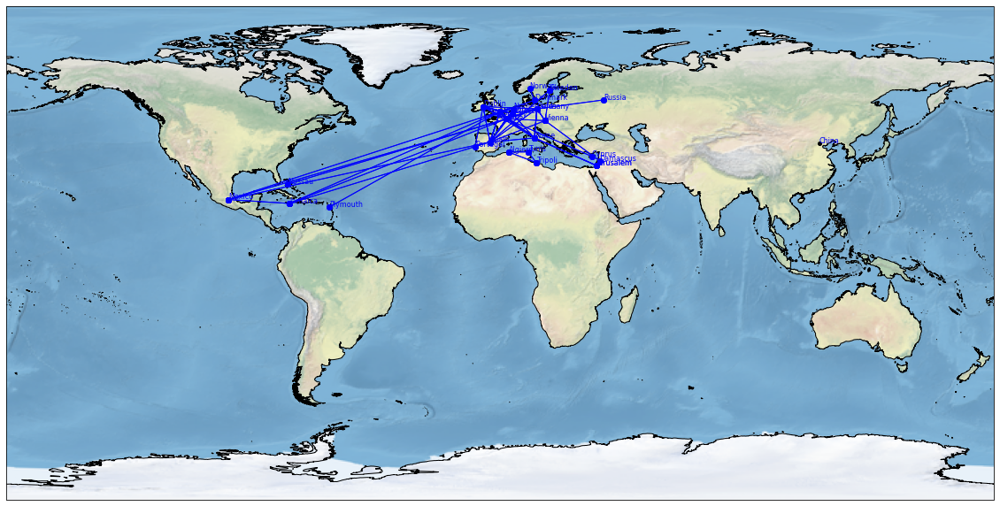

In [ ]:
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

plt.figure(figsize=(20, 40))
ax = plt.axes(projection=ccrs.PlateCarree())
print(f"ax type: {type(ax)}")
ax.coastlines(resolution='10m', color='black', linewidth=1) # draw with batter coaslines resolution
for r in sf_country_capitals:
    lon, lat, name = r['CapitalLongitude'], r['CapitalLatitude'], r['CapitalName']
    if r['capital_lower'] not in nodes_set:
      name = r['CountryName']
    plt.plot(lon, lat,
         color='black', marker='o', markersize=4,transform=ccrs.PlateCarree(),
         )
    ax.text(lon, lat+0.2, name, fontsize=8, color="blue", transform=ccrs.PlateCarree(),)

for link in links_list:
  r = sf_country_capitals[sf_country_capitals['capital_lower'] == link[0]]
  if r.shape[0]==0:
    r = sf_country_capitals[sf_country_capitals['country_lower'] == link[0]]
    if r.shape[0]==0:
      continue
  e1_long, e1_lat = r['CapitalLongitude'][0], r['CapitalLatitude'][0]
  r = sf_country_capitals[sf_country_capitals['capital_lower'] == link[1]]
  if r.shape[0]==0:
    r = sf_country_capitals[sf_country_capitals['country_lower'] == link[1]]
    if r.shape[0]==0:
      continue
  e2_long, e2_lat = r['CapitalLongitude'][0], r['CapitalLatitude'][0]
  # print( e1_long, e1_lat,e2_long, e2_lat)
  plt.plot([e1_long, e2_long], [e1_lat, e2_lat],color='blue', linewidth=1, marker='o', transform=ccrs.PlateCarree())

ax.stock_img() # add colors 


**Question 2:** Select a country's' statistic from the [World Development Indicators dataset](https://www.kaggle.com/worldbank/world-development-indicators) (Please notice there are several files in the dataset, such as _Indicators.csv_).
Then, create a choropleth map displaying how the selected statistics changed over time (15pt) 
    
**Bonus:** Create a short animation that displays how the chosen statistics changed over time (15pt)

In [ ]:
import kaggle
!mkdir ./datasets

In [ ]:
!mkdir ./datasets/world_development_indicators

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d worldbank/world-development-indicators -p ./datasets/
!unzip ./datasets/world-development-indicators.zip  -d ./datasets/world_development_indicators

 98% 360M/369M [00:03<00:00, 130MB/s]
100% 369M/369M [00:03<00:00, 112MB/s]
Archive:  ./datasets/world-development-indicators.zip
  inflating: ./datasets/world_development_indicators/Country.csv  
  inflating: ./datasets/world_development_indicators/CountryNotes.csv  
  inflating: ./datasets/world_development_indicators/Footnotes.csv  
  inflating: ./datasets/world_development_indicators/Indicators.csv  
  inflating: ./datasets/world_development_indicators/Series.csv  
  inflating: ./datasets/world_development_indicators/SeriesNotes.csv  
  inflating: ./datasets/world_development_indicators/database.sqlite  
  inflating: ./datasets/world_development_indicators/hashes.txt  


In [ ]:
import turicreate as tc
import turicreate.aggregate as agg

dataset_path = "./datasets/world_development_indicators"
sf_country = tc.SFrame.read_csv(f"{dataset_path}/Country.csv")
sf_country = sf_country['CountryCode','ShortName']
sf_country

Finished parsing file /content/datasets/world_development_indicators/Country.csv

Parsing completed. Parsed 100 lines in 0.137261 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,float,float,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/datasets/world_development_indicators/Country.csv

Parsing completed. Parsed 247 lines in 0.020082 secs.

CountryCode,ShortName
AFG,Afghanistan
ALB,Albania
DZA,Algeria
ASM,American Samoa
ADO,Andorra
AGO,Angola
ATG,Antigua and Barbuda
ARB,Arab World
ARG,Argentina
ARM,Armenia


In [ ]:
dataset_path = "./datasets/world_development_indicators"
sf_indicators = tc.SFrame.read_csv(f"{dataset_path}/Indicators.csv")
sf_indicators = sf_indicators[sf_indicators['IndicatorCode'] == 'IT.CEL.SETS.P2']
sf_indicators = sf_indicators['CountryCode','Year','Value']
sf_indicators

Finished parsing file /content/datasets/world_development_indicators/Indicators.csv

Parsing completed. Parsed 100 lines in 2.70354 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,str,str,int,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 528165 lines. Lines per second: 219372

Read 3128826 lines. Lines per second: 400647

Finished parsing file /content/datasets/world_development_indicators/Indicators.csv

Parsing completed. Parsed 5656458 lines in 12.5272 secs.

CountryCode,Year,Value
ARB,1960,0.0
CSS,1960,0.0
CEB,1960,0.0
EAS,1960,0.0
EAP,1960,0.0
EMU,1960,0.0
ECS,1960,0.0
ECA,1960,0.0
EUU,1960,0.0
FCS,1960,0.0


In [ ]:
sf = sf_country.join(sf_indicators, on='CountryCode')
sf

CountryCode,ShortName,Year,Value
ARB,Arab World,1960,0.0
CSS,Caribbean small states,1960,0.0
CEB,Central Europe and theBaltics ...,1960,0.0
EAS,East Asia & Pacific (allincome levels) ...,1960,0.0
EAP,East Asia & Pacific(developing only) ...,1960,0.0
EMU,Euro area,1960,0.0
ECS,Europe & Central Asia(all income levels) ...,1960,0.0
ECA,Europe & Central Asia(developing only) ...,1960,0.0
EUU,European Union,1960,0.0
FCS,Fragile and conflictaffected situations ...,1960,0.0


In [ ]:
sf[sf['CountryCode']=='TZA']

CountryCode,ShortName,Year,Value
TZA,Tanzania,1960,0.0
TZA,Tanzania,1965,0.0
TZA,Tanzania,1970,0.0
TZA,Tanzania,1975,0.0
TZA,Tanzania,1976,0.0
TZA,Tanzania,1977,0.0
TZA,Tanzania,1978,0.0
TZA,Tanzania,1979,0.0
TZA,Tanzania,1980,0.0
TZA,Tanzania,1981,0.0


In [ ]:
# These examples are inspired from http://geopandas.org/mapping.html
import geopandas
import matplotlib.pyplot as plt
%matplotlib inline

print(geopandas.datasets.get_path('naturalearth_lowres'))
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))
world.head(10)

/usr/local/lib/python3.7/dist-packages/geopandas/datasets/naturalearth_lowres/naturalearth_lowres.shp


,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
5,18556698,Asia,Kazakhstan,KAZ,460700.0,"POLYGON ((87.35997 49.21498, 86.59878 48.54918..."
6,29748859,Asia,Uzbekistan,UZB,202300.0,"POLYGON ((55.96819 41.30864, 55.92892 44.99586..."
7,6909701,Oceania,Papua New Guinea,PNG,28020.0,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ..."
8,260580739,Asia,Indonesia,IDN,3028000.0,"MULTIPOLYGON (((141.00021 -2.60015, 141.01706 ..."
9,44293293,South America,Argentina,ARG,879400.0,"MULTIPOLYGON (((-68.63401 -52.63637, -68.25000..."


In [ ]:
import pandas as pd
df_indicators = pd.DataFrame(sf_indicators)
years = df_indicators['Year'].unique()
df_indicators

,CountryCode,Year,Value
0,ARB,1960,0.000000
1,CSS,1960,0.000000
2,CEB,1960,0.000000
3,EAS,1960,0.000000
4,EAP,1960,0.000000
...,...,...,...
9912,VNM,2014,147.110888
9913,WBG,2014,72.075153
9914,YEM,2014,68.486271
9915,ZMB,2014,67.338164


In [ ]:
def create_map_by_year(df,year):
  tmp_df = df[df['Year'] == year]
  fig, ax = plt.subplots()
  ax.set_aspect('equal')
  return tmp_df.plot(ax=ax, column="Value",  cmap='OrRd', legend=True  )
df = world.merge(df_indicators, left_on='iso_a3', right_on='CountryCode')

Text(0.5, 1.0, 'Mobile cellular subscriptions (per 100) over Years:')

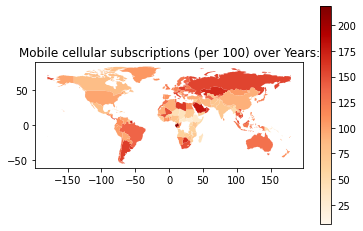

In [ ]:
ax = create_map_by_year(df,2014)
plt.title('Mobile cellular subscriptions (per 100) over Years:')

In [ ]:
from tqdm import tqdm
import imageio # need install imageio 
!mkdir ./images

images_path = "./images/"
images_list = []
for y in tqdm(years):
    ax = create_map_by_year(df, y)
    img_path = f"{images_path}/{y}_cellular.png"
    plt.savefig(img_path)
    images_list.append(img_path)
    plt.clf()

images = []
for filename in images_list:
    images.append(imageio.imread(filename))
imageio.mimsave(f"{images_path}/all_cellular.gif", images, duration=1 )


 47%|████▋     | 20/43 [00:08<00:09,  2.38it/s]/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
 49%|████▉     | 21/43 [00:08<00:09,  2.42it/s]/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
 51%|█████     | 22/43 [00:09<00:09,  2.24it/s]/usr/local/lib/python3.7/dist

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

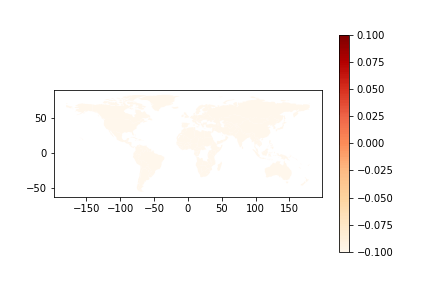

In [ ]:
from IPython.display import Image
Image('./images/all_cellular.gif', format='png')

**Question 3:** Select a request type from [San Francisco 311 dataset](https://www.kaggle.com/datasf/case-data-from-san-francisco-311).
Create an interactive map that somehow presents in which areas this request occurs the most (35pt).

In [3]:
import kaggle
!mkdir ./datasets

In [4]:
!mkdir ./datasets/world_development_indicators

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d datasf/case-data-from-san-francisco-311 -p ./datasets/
!unzip ./datasets/case-data-from-san-francisco-311.zip  -d ./datasets/case_data_from_san_francisco_311A

 97% 119M/122M [00:00<00:00, 119MB/s] 
100% 122M/122M [00:00<00:00, 133MB/s]
Archive:  ./datasets/case-data-from-san-francisco-311.zip
  inflating: ./datasets/case_data_from_san_francisco_311A/Case_Data_from_San_Francisco_311__SF311.csv  
  inflating: ./datasets/case_data_from_san_francisco_311A/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.dbf  
  inflating: ./datasets/case_data_from_san_francisco_311A/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.prj  
  inflating: ./datasets/case_data_from_san_francisco_311A/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.shp  
  inflating: ./datasets/case_data_from_san_francisco_311A/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.shx  
  inflating: ./datasets/case_data_from_san_francisco_311A/Shapefiles (2)/Supervisor Districts as of April 2012/geo_export_38fd3153-0303-488e-9f3c-0f81e8e00115.db

In [1]:
import turicreate as tc
import turicreate.aggregate as agg
sf_San_Francisco = tc.SFrame.read_csv("/content/datasets/case_data_from_san_francisco_311A/Case_Data_from_San_Francisco_311__SF311.csv")
sf_San_Francisco

Finished parsing file /content/datasets/case_data_from_san_francisco_311A/Case_Data_from_San_Francisco_311__SF311.csv

Parsing completed. Parsed 100 lines in 3.63878 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,str,str,str,str,str,str,str,str,int,str,str,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 189228 lines. Lines per second: 62183.9

Read 733045 lines. Lines per second: 89078.1

Unexpected characters after last column. "Abandoned Vehicle - Car4door"
Parse failed at token ending at: 
	s Work Queue,Abandoned Vehicle,Abandoned Vehicle - Car4door,^Gray - Volkswagen -  - 7MJV079,Intersection of 2
Successfully parsed 16 tokens: 
	0: 5526685
	1: 02/02/2016 ... 5:55:47 AM
	2: 02/03/2016 ... 1:21:40 AM
	3: 02/03/2016 ... 1:21:40 AM
	4: Closed
	5: "Case Reso ... 1256715196
	6: -122.391840449142)"
	7: Voice In
	8: 5698025
	9: 03/24/2016 ... 8:34:48 PM
	10: 03/29/2016 ... 8:25:01 AM
	11: 3
	12: Closed
	13: DPT Abando ...       #229
	14: DPT Abando ... Work Queue
	15: Abandoned Vehicle

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Unable to interpret "(415)-252-380"" as a integer
Parse failed at token ending at: 
	 (415)-252-380",^DPH - Environmental Health - G,General Requests,
Successfully parsed 0 tokens:

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Unable to interpret "(415)-252-380"" as a integer
Parse failed at token ending at: 
	 (415)-252-380",^DPH - Environmental Health - G,Noise Report,mech
Successfully parsed 0 tokens:

Unexpected characters after last column. "DPW Ops Queue"
Parse failed at token ending at: 
	:00:36 AM,Closed,Case Resolved - duplicate sr,DPW Ops Queue,^Street and Sidewalk Cleaning,Illegal Encampment,
Successfully parsed 16 tokens: 
	0: 415
	1: DPH - Envi ... Health - G
	2: Street and ... k Cleaning
	3: Hazardous Materials
	4: Needles
	5: Intersecti ... and 8TH ST
	6: 10
	7: Showplace Square
	8: (37.767300 ... 428647996)
	9: Voice In
	10: 5698219
	11: 3
	12: 03/25/2016 ... 7:00:36 AM
	13: 03/25/2016 ... 7:00:36 AM
	14: Closed
	15: Case Resol ... plicate sr

Unexpected characters after last column. "DPW Ops Queue"
Parse failed at token ending at: 
	/2016 01:00:00 AM,Closed,Case Resolved - done,DPW Ops Queue,^Street and Sidewalk Cleaning,Hazardous Materials
Successfully parsed 16 tokens: 
	0: 415
	1: DPH - Envi ... Health - G
	2: Street and ... k Cleaning
	3: Hazardous Materials
	4: Needles
	5: Intersecti ...  HOWARD ST
	6: 6
	7: South of Market
	8: (37.773100 ... 561380814)
	9: Voice In
	10: 5698609
	11: 3
	12: 03/29/2016 ... 1:00:00 AM
	13: 03/29/2016 ... 1:00:00 AM
	14: Closed
	15: Case Resolved - done

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Unable to interpret "(415)-252-380"" as a integer
Parse failed at token ending at: 
	 (415)-252-380",^DPH - Environmental Health - G,Noise Report,garb
Successfully parsed 0 tokens:

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Read 1161364 lines. Lines per second: 83198.1

16596 lines failed to parse correctly

Finished parsing file /content/datasets/case_data_from_san_francisco_311A/Case_Data_from_San_Francisco_311__SF311.csv

Parsing completed. Parsed 1161482 lines in 18.483 secs.

CaseID,Opened,Closed,Updated,Status,Status Notes
322571,11/30/2008 11:53:00 PM,12/01/2008 03:19:00 PM,12/01/2008 03:19:00 PM,Closed,
322568,11/30/2008 11:13:00 PM,07/21/2009 04:24:00 PM,07/21/2009 04:24:00 PM,Closed,
322567,11/30/2008 11:07:00 PM,12/27/2008 06:07:00 AM,12/27/2008 06:07:00 AM,Closed,
322566,11/30/2008 10:56:00 PM,07/21/2009 04:24:00 PM,07/21/2009 04:24:00 PM,Closed,
322565,11/30/2008 10:46:00 PM,12/13/2008 10:50:00 AM,12/13/2008 10:50:00 AM,Closed,
322564,11/30/2008 10:43:00 PM,12/01/2008 04:07:00 PM,12/01/2008 04:07:00 PM,Closed,
322560,11/30/2008 10:24:00 PM,07/21/2009 04:24:00 PM,07/21/2009 04:24:00 PM,Closed,
322559,11/30/2008 10:20:00 PM,12/01/2008 06:07:00 AM,12/01/2008 06:07:00 AM,Closed,
322558,11/30/2008 10:04:00 PM,11/30/2008 10:18:00 PM,11/30/2008 10:18:00 PM,Closed,
322556,11/30/2008 09:34:00 PM,12/09/2008 08:07:00 AM,12/09/2008 08:07:00 AM,Closed,


In [9]:
from collections import Counter
x = Counter(sf_San_Francisco['Request Type'])
dict(sorted(x.items(), key=lambda item: item[1] ,reverse=True))

{'Sidewalk_Cleaning': 171590,
 'Not_Offensive Graffiti on Private Property': 65012,
 'Offensive Graffiti on Public Property': 60074,
 'General Cleaning': 58892,
 'Bulky Items': 58239,
 'Not_Offensive Graffiti on Public Property': 50667,
 'Illegal_Dumping': 44571,
 'Damaged Parking_Meter': 36102,
 'SFHA Priority - Urgent': 28751,
 'Abandoned Vehicle - Car4door': 28161,
 'Hazardous Materials': 25822,
 'Pavement_Defect': 22031,
 'Streetlight - Light_Burnt_Out': 19840,
 'Abandoned Vehicle - Other': 18374,
 'Offensive Graffiti on Private Property': 17983,
 'Sewage_back_up': 17838,
 'Street_Cleaning': 17511,
 'Abandoned Vehicle - Car2door': 14428,
 'SFHA Priority - Emergency': 13735,
 'Cans_Left_Out_24x7': 12046,
 'Sidewalk_Defect': 11463,
 'Sign - Defaced': 10555,
 'SFHA Priority - Routine': 10543,
 'Trees - Damaged_Tree': 10498,
 'Abandoned Vehicle - PickupTruck': 9838,
 'Graffiti': 9671,
 'Park - Structural_Maintenance': 9469,
 'Illegal Encampment': 8943,
 'Temporary Sign Request for Movi

In [18]:
# sf_graffiti = sf_San_Francisco[sf_San_Francisco['Request Type']=='Offensive Graffiti on Public Property']
sf_graffiti = sf_San_Francisco[sf_San_Francisco.apply(lambda r: r['Request Type']=='Offensive Graffiti on Public Property' or r['Request Type']=='Offensive Graffiti on Private Property')]
sf_graffiti

CaseID,Opened,Closed,Updated,Status,Status Notes
322564,11/30/2008 10:43:00 PM,12/01/2008 04:07:00 PM,12/01/2008 04:07:00 PM,Closed,
322548,11/30/2008 08:48:00 PM,12/13/2008 11:07:00 AM,12/13/2008 11:07:00 AM,Closed,
322438,11/30/2008 02:04:00 PM,03/04/2009 01:10:00 PM,03/04/2009 01:10:00 PM,Closed,
322335,11/30/2008 09:36:00 AM,06/04/2009 05:11:00 PM,06/04/2009 05:11:00 PM,Closed,
322164,11/29/2008 03:59:00 PM,07/21/2009 04:23:00 PM,07/21/2009 04:23:00 PM,Closed,
322068,11/29/2008 11:43:00 AM,07/21/2009 04:18:00 PM,07/21/2009 04:18:00 PM,Closed,
322015,11/29/2008 09:47:00 AM,07/21/2009 04:18:00 PM,07/21/2009 04:18:00 PM,Closed,
321983,11/29/2008 07:41:00 AM,07/20/2009 11:11:00 AM,07/20/2009 11:11:00 AM,Closed,
321982,11/29/2008 07:40:00 AM,07/21/2009 04:18:00 PM,07/21/2009 04:18:00 PM,Closed,
321981,11/29/2008 07:39:00 AM,03/04/2009 01:10:00 PM,03/04/2009 01:10:00 PM,Closed,


Display San Francisco Offensive Graffiti Map:
points in green for Public Property
and points in red for Private Property

In [54]:
tiles = 'Stamen Terrain'
m = folium.Map(location=[37.733795, -122.446747], 
               zoom_start=12,
               tiles = tiles)

# topop = sf_graffiti['Request Details'].apply(lambda s:s.split('-')[0])
# colors = sf_graffiti['Request Type'].apply(lambda s:'green' if s == 'Offensive Graffiti on Public Property' else 'red')
# points = sf_graffiti['Point']


for r in sf_graffiti[:10000]:
  try:
    popup = r['Request Details'].split('-')[0]
    p_arr = r['Point'].split('(')[1].split(')')[0].split(', ')
    location = [float(p_arr[0]),float(p_arr[1])]
    if r['Request Type'] == 'Offensive Graffiti on Public Property':
      color = 'green'
    else:
      color='red'
    folium.Marker(
        location=location, # coordinates for the marker (Earth Lab at CU Boulder)
        popup= popup,
        icon=folium.Icon(color=color, icon='info-sign')
    ).add_to(m)
  except:
    continue
m  